### Notebook for the functional comparison of CMC genotypes with `expimap`

- **Developed by:** Carlos Talavera-López Ph.D
- **Würzburg Institute for Systems Immunology - Faculty of Medicine - Julius-Maximilian-Universität Würzburg**
- **Created on**: 240216
- **Last modified**: 240216

### Import required modules

In [1]:
import gdown
import torch
import anndata
import warnings
import numpy as np
import scipy as sp
import scanpy as sc
import pandas as pd
import scarches as sca
import matplotlib.pyplot as plt

/home/ruth/mambaforge/envs/expimap/lib/python3.10/site-packages/scvi/_settings.py:63: UserWarning: Since v1.0.0, scvi-tools no longer uses a random seed by default. Run `scvi.settings.seed = 0` to reproduce results from previous versions.
  self.seed = seed
/home/ruth/mambaforge/envs/expimap/lib/python3.10/site-packages/scvi/_settings.py:70: UserWarning: Setting `dl_pin_memory_gpu_training` is deprecated in v1.0 and will be removed in v1.1. Please pass in `pin_memory` to the data loaders instead.
  self.dl_pin_memory_gpu_training = (
 captum (see https://github.com/pytorch/captum).


### Set up working environment

In [2]:
sc.settings.verbosity = 3
sc.logging.print_versions()
sc.settings.set_figure_params(dpi = 180, color_map = 'magma_r', dpi_save = 300, vector_friendly = True, format = 'svg')

-----
anndata     0.10.5.post1
scanpy      1.9.8
-----
PIL                 10.2.0
absl                NA
aiohttp             3.9.3
aiosignal           1.3.1
annotated_types     0.6.0
anyio               NA
array_api_compat    1.4.1
asttokens           NA
async_timeout       4.0.3
attr                23.2.0
backoff             2.2.1
bs4                 4.12.3
certifi             2024.02.02
charset_normalizer  3.3.2
chex                0.1.7
click               8.1.7
comm                0.2.1
contextlib2         NA
croniter            NA
cycler              0.12.1
cython_runtime      NA
dateutil            2.8.2
debugpy             1.8.1
decorator           5.1.1
deepdiff            6.7.1
docrep              0.3.2
etils               1.6.0
exceptiongroup      1.2.0
executing           2.0.1
fastapi             0.109.2
filelock            3.13.1
flax                0.8.1
frozenlist          1.4.1
fsspec              2024.2.0
gdown               4.7.3
h5py                3.10.0
idna       

In [3]:
warnings.simplefilter(action = 'ignore')
%config InlineBackend.print_figure_kwargs = {'facecolor' : "w"}
%config InlineBackend.figure_format = 'retina'
torch.set_float32_matmul_precision('medium')

### Read in whole data and split in WT (reference) and other genotypes (query)

In [4]:
Kdm6aKO_CMC = sc.read_h5ad('../../data/Kdm6aKO_ALL_GEX_CMC_states_ctl240311.raw.h5ad')
Kdm6aKO_CMC

AnnData object with n_obs × n_vars = 10793 × 32285
    obs: 'cell_source', 'cell_type', 'donor', 'n_counts', 'n_genes', 'percent_mito', 'percent_ribo', 'region', 'sample', 'scrublet_score', 'cell_states', 'seed_labels', 'genotype', 'group', 'file', 'batch', 'doublet_scores', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'pct_counts_ribo', 'percent_mt2', 'percent_chrY', 'XIST-counts', 'S_score', 'G2M_score', '_scvi_batch', '_scvi_labels', 'C_scANVI'
    var: 'gene_ids', 'feature_types', 'genome', 'modality', 'mt', 'ribo', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts'
    obsm: 'X_scANVI', 'X_scVI', 'X_umap'

In [5]:
if sp.sparse.issparse(Kdm6aKO_CMC.X):
    Kdm6aKO_CMC.X = Kdm6aKO_CMC.X.toarray().astype(np.float32)

In [6]:
Kdm6aKO_CMC.obs['genotype'].value_counts()

WT      3219
Sham    2939
Tx      2348
KO      2287
Name: genotype, dtype: int64

In [7]:
WT_CMC = Kdm6aKO_CMC[Kdm6aKO_CMC.obs['genotype'].isin(['WT'])]
WT_CMC

View of AnnData object with n_obs × n_vars = 3219 × 32285
    obs: 'cell_source', 'cell_type', 'donor', 'n_counts', 'n_genes', 'percent_mito', 'percent_ribo', 'region', 'sample', 'scrublet_score', 'cell_states', 'seed_labels', 'genotype', 'group', 'file', 'batch', 'doublet_scores', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'pct_counts_ribo', 'percent_mt2', 'percent_chrY', 'XIST-counts', 'S_score', 'G2M_score', '_scvi_batch', '_scvi_labels', 'C_scANVI'
    var: 'gene_ids', 'feature_types', 'genome', 'modality', 'mt', 'ribo', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts'
    obsm: 'X_scANVI', 'X_scVI', 'X_umap'

In [8]:
Sham_CMC = Kdm6aKO_CMC[Kdm6aKO_CMC.obs['genotype'].isin(['Sham'])]
Sham_CMC

View of AnnData object with n_obs × n_vars = 2939 × 32285
    obs: 'cell_source', 'cell_type', 'donor', 'n_counts', 'n_genes', 'percent_mito', 'percent_ribo', 'region', 'sample', 'scrublet_score', 'cell_states', 'seed_labels', 'genotype', 'group', 'file', 'batch', 'doublet_scores', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'pct_counts_ribo', 'percent_mt2', 'percent_chrY', 'XIST-counts', 'S_score', 'G2M_score', '_scvi_batch', '_scvi_labels', 'C_scANVI'
    var: 'gene_ids', 'feature_types', 'genome', 'modality', 'mt', 'ribo', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts'
    obsm: 'X_scANVI', 'X_scVI', 'X_umap'

In [9]:
Tx_CMC = Kdm6aKO_CMC[Kdm6aKO_CMC.obs['genotype'].isin(['Tx'])]
Tx_CMC

View of AnnData object with n_obs × n_vars = 2348 × 32285
    obs: 'cell_source', 'cell_type', 'donor', 'n_counts', 'n_genes', 'percent_mito', 'percent_ribo', 'region', 'sample', 'scrublet_score', 'cell_states', 'seed_labels', 'genotype', 'group', 'file', 'batch', 'doublet_scores', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'pct_counts_ribo', 'percent_mt2', 'percent_chrY', 'XIST-counts', 'S_score', 'G2M_score', '_scvi_batch', '_scvi_labels', 'C_scANVI'
    var: 'gene_ids', 'feature_types', 'genome', 'modality', 'mt', 'ribo', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts'
    obsm: 'X_scANVI', 'X_scVI', 'X_umap'

In [10]:
KO_CMC = Kdm6aKO_CMC[Kdm6aKO_CMC.obs['genotype'].isin(['KO'])]
KO_CMC

View of AnnData object with n_obs × n_vars = 2287 × 32285
    obs: 'cell_source', 'cell_type', 'donor', 'n_counts', 'n_genes', 'percent_mito', 'percent_ribo', 'region', 'sample', 'scrublet_score', 'cell_states', 'seed_labels', 'genotype', 'group', 'file', 'batch', 'doublet_scores', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'pct_counts_ribo', 'percent_mt2', 'percent_chrY', 'XIST-counts', 'S_score', 'G2M_score', '_scvi_batch', '_scvi_labels', 'C_scANVI'
    var: 'gene_ids', 'feature_types', 'genome', 'modality', 'mt', 'ribo', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts'
    obsm: 'X_scANVI', 'X_scVI', 'X_umap'

### Read the Reactome annotations

In [11]:
url = 'https://drive.google.com/uc?id=1136LntaVr92G1MphGeMVcmpE0AqcqM6c'
output = 'reactome.gmt'
gdown.download(url, output, quiet=False)

Downloading...
From: https://drive.google.com/uc?id=1136LntaVr92G1MphGeMVcmpE0AqcqM6c
To: /home/ruth/github/Kdm6aKO/3-functional_characterisation_expimap/1-compare_CMC-genotype_expimap/reactome.gmt
100%|██████████| 331k/331k [00:00<00:00, 11.4MB/s]


'reactome.gmt'

### Prepare reference data with ReactomeDB pathways

In [12]:
sca.utils.add_annotations(WT_CMC, 'reactome.gmt', min_genes = 6, clean = True)

- Remove all genes that are present in the data but absent in ReactomeDB

In [13]:
WT_CMC._inplace_subset_var(WT_CMC.varm['I'].sum(1)>0)

### Calculate HVGs

In [14]:
ref_raw = WT_CMC.copy()
WT_CMC.layers['counts'] = WT_CMC.X.copy()

sc.pp.highly_variable_genes(
    WT_CMC,
    flavor = "seurat_v3",
    n_top_genes = 7000,
    layer = "counts",
    batch_key = "sample",
    subset = True,
    span = 1
)
WT_CMC

If you pass `n_top_genes`, all cutoffs are ignored.
extracting highly variable genes
--> added
    'highly_variable', boolean vector (adata.var)
    'highly_variable_rank', float vector (adata.var)
    'means', float vector (adata.var)
    'variances', float vector (adata.var)
    'variances_norm', float vector (adata.var)


AnnData object with n_obs × n_vars = 3219 × 4827
    obs: 'cell_source', 'cell_type', 'donor', 'n_counts', 'n_genes', 'percent_mito', 'percent_ribo', 'region', 'sample', 'scrublet_score', 'cell_states', 'seed_labels', 'genotype', 'group', 'file', 'batch', 'doublet_scores', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'pct_counts_ribo', 'percent_mt2', 'percent_chrY', 'XIST-counts', 'S_score', 'G2M_score', '_scvi_batch', '_scvi_labels', 'C_scANVI'
    var: 'gene_ids', 'feature_types', 'genome', 'modality', 'mt', 'ribo', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'highly_variable_nbatches'
    uns: 'terms', 'hvg'
    obsm: 'X_scANVI', 'X_scVI', 'X_umap'
    varm: 'I'
    layers: 'counts'

- Filter out all annotations (terms) with less than 12 genes.

In [15]:
select_terms = WT_CMC.varm['I'].sum(0)>12
WT_CMC.uns['terms'] = np.array(WT_CMC.uns['terms'])[select_terms].tolist()
WT_CMC.varm['I'] = WT_CMC.varm['I'][:, select_terms]

- Filter out genes not present in any of the terms after selection of HVGs.

In [16]:
WT_CMC._inplace_subset_var(WT_CMC.varm['I'].sum(1)>0)

### Create expiMap model and train it on reference dataset

In [17]:
intr_cvae = sca.models.EXPIMAP(
    adata = WT_CMC,
    condition_key = 'genotype',
    hidden_layer_sizes = [256, 256, 256],
    recon_loss = 'nb'
)


INITIALIZING NEW NETWORK..............
Encoder Architecture:
	Input Layer in, out and cond: 4824 256 1
	Hidden Layer 1 in/out: 256 256
	Hidden Layer 2 in/out: 256 256
	Mean/Var Layer in/out: 256 546
Decoder Architecture:
	Masked linear layer in, ext_m, ext, cond, out:  546 0 0 1 4824
	with hard mask.
Last Decoder layer: softmax


In [18]:
ALPHA = 0.7

In [19]:
early_stopping_kwargs = {
    "early_stopping_metric": "val_unweighted_loss", # val_unweighted_loss
    "threshold": 0,
    "patience": 50,
    "reduce_lr": True,
    "lr_patience": 13,
    "lr_factor": 0.1,
}
intr_cvae.train(
    n_epochs = 400,
    alpha_epoch_anneal = 100,
    alpha = ALPHA,
    alpha_kl = 0.5,
    weight_decay = 0.,
    early_stopping_kwargs = early_stopping_kwargs,
    use_early_stopping = True,
    monitor_only_val = False,
    seed = 1712,
)

Preparing (3219, 4824)
Instantiating dataset
Init the group lasso proximal operator for the main terms.
 |██████--------------| 30.0%  - epoch_loss: 2124.2237230384 - epoch_recon_loss: 2052.9462200662 - epoch_kl_loss: 142.5550105883 - val_loss: 2381.3691406250 - val_recon_loss: 2308.8496093750 - val_kl_loss: 145.03909810380
ADJUSTED LR
 |███████-------------| 39.0%  - epoch_loss: 2132.9676089079 - epoch_recon_loss: 2063.8791981573 - epoch_kl_loss: 138.1768221648 - val_loss: 2403.0295410156 - val_recon_loss: 2331.1832682292 - val_kl_loss: 143.6925710042
ADJUSTED LR
 |████████------------| 42.2%  - epoch_loss: 2141.4480723505 - epoch_recon_loss: 2072.5440939198 - epoch_kl_loss: 137.8079561980 - val_loss: 2372.6289876302 - val_recon_loss: 2301.3457031250 - val_kl_loss: 142.5664825439
ADJUSTED LR
 |█████████-----------| 45.5%  - epoch_loss: 2145.6603579314 - epoch_recon_loss: 2076.8762419327 - epoch_kl_loss: 137.5681749427 - val_loss: 2367.3321940104 - val_recon_loss: 2295.9492187500 - val

In [20]:
MEAN = False

In [21]:
WT_CMC.obsm['X_cvae'] = intr_cvae.get_latent(mean = MEAN, only_active = True)

### Plot latent space of the reference dataset

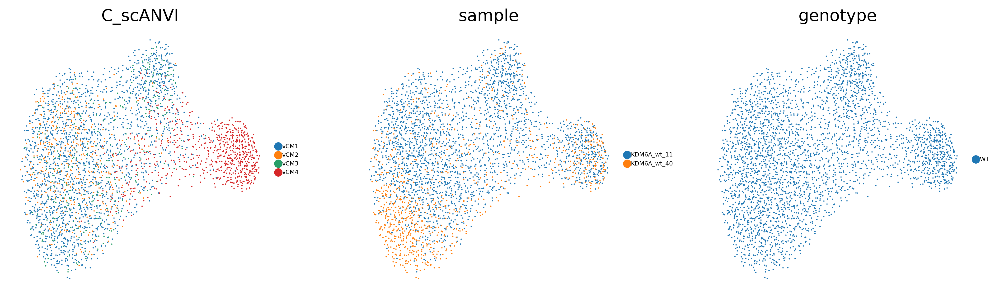

In [23]:
sc.pp.neighbors(WT_CMC, use_rep = "X_cvae", n_neighbors = 50, metric = 'minkowski')
sc.tl.umap(WT_CMC, min_dist = 0.3, spread = 4, random_state = 1712)
sc.pl.umap(WT_CMC, frameon = False, color = ['C_scANVI', 'sample', 'genotype'], size = 5, legend_fontsize = 5, ncols = 4)

### Read and format query dataset

In [24]:
Sham_CMC = Sham_CMC[:, WT_CMC.var_names].copy()
Sham_CMC.uns['terms'] = WT_CMC.uns['terms']
Sham_CMC

AnnData object with n_obs × n_vars = 2939 × 4824
    obs: 'cell_source', 'cell_type', 'donor', 'n_counts', 'n_genes', 'percent_mito', 'percent_ribo', 'region', 'sample', 'scrublet_score', 'cell_states', 'seed_labels', 'genotype', 'group', 'file', 'batch', 'doublet_scores', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'pct_counts_ribo', 'percent_mt2', 'percent_chrY', 'XIST-counts', 'S_score', 'G2M_score', '_scvi_batch', '_scvi_labels', 'C_scANVI'
    var: 'gene_ids', 'feature_types', 'genome', 'modality', 'mt', 'ribo', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts'
    uns: 'terms'
    obsm: 'X_scANVI', 'X_scVI', 'X_umap'

In [25]:
Tx_CMC = Tx_CMC[:, WT_CMC.var_names].copy()
Tx_CMC.uns['terms'] = WT_CMC.uns['terms']
Tx_CMC

AnnData object with n_obs × n_vars = 2348 × 4824
    obs: 'cell_source', 'cell_type', 'donor', 'n_counts', 'n_genes', 'percent_mito', 'percent_ribo', 'region', 'sample', 'scrublet_score', 'cell_states', 'seed_labels', 'genotype', 'group', 'file', 'batch', 'doublet_scores', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'pct_counts_ribo', 'percent_mt2', 'percent_chrY', 'XIST-counts', 'S_score', 'G2M_score', '_scvi_batch', '_scvi_labels', 'C_scANVI'
    var: 'gene_ids', 'feature_types', 'genome', 'modality', 'mt', 'ribo', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts'
    uns: 'terms'
    obsm: 'X_scANVI', 'X_scVI', 'X_umap'

In [26]:
KO_CMC = KO_CMC[:, WT_CMC.var_names].copy()
KO_CMC.uns['terms'] = WT_CMC.uns['terms']
KO_CMC

AnnData object with n_obs × n_vars = 2287 × 4824
    obs: 'cell_source', 'cell_type', 'donor', 'n_counts', 'n_genes', 'percent_mito', 'percent_ribo', 'region', 'sample', 'scrublet_score', 'cell_states', 'seed_labels', 'genotype', 'group', 'file', 'batch', 'doublet_scores', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'pct_counts_ribo', 'percent_mt2', 'percent_chrY', 'XIST-counts', 'S_score', 'G2M_score', '_scvi_batch', '_scvi_labels', 'C_scANVI'
    var: 'gene_ids', 'feature_types', 'genome', 'modality', 'mt', 'ribo', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts'
    uns: 'terms'
    obsm: 'X_scANVI', 'X_scVI', 'X_umap'

In [38]:
query = Sham_CMC.concatenate(Tx_CMC, KO_CMC, batch_key = 'experiment', batch_categories = ['Sham', 'Tx', 'KO'], join = 'inner')
query.uns['terms'] = WT_CMC.uns['terms']
query

AnnData object with n_obs × n_vars = 7574 × 4824
    obs: 'cell_source', 'cell_type', 'donor', 'n_counts', 'n_genes', 'percent_mito', 'percent_ribo', 'region', 'sample', 'scrublet_score', 'cell_states', 'seed_labels', 'genotype', 'group', 'file', 'batch', 'doublet_scores', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'pct_counts_ribo', 'percent_mt2', 'percent_chrY', 'XIST-counts', 'S_score', 'G2M_score', '_scvi_batch', '_scvi_labels', 'C_scANVI', 'experiment'
    var: 'gene_ids', 'feature_types', 'genome', 'modality', 'mt', 'ribo', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts'
    uns: 'terms'
    obsm: 'X_scANVI', 'X_scVI', 'X_umap'

### Initlizling the model for query training

In [39]:
q_intr_cvae = sca.models.EXPIMAP.load_query_data(query, intr_cvae)

AnnData object with n_obs × n_vars = 7574 × 4824
    obs: 'cell_source', 'cell_type', 'donor', 'n_counts', 'n_genes', 'percent_mito', 'percent_ribo', 'region', 'sample', 'scrublet_score', 'cell_states', 'seed_labels', 'genotype', 'group', 'file', 'batch', 'doublet_scores', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'pct_counts_ribo', 'percent_mt2', 'percent_chrY', 'XIST-counts', 'S_score', 'G2M_score', '_scvi_batch', '_scvi_labels', 'C_scANVI', 'experiment'
    var: 'gene_ids', 'feature_types', 'genome', 'modality', 'mt', 'ribo', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts'
    uns: 'terms'
    obsm: 'X_scANVI', 'X_scVI', 'X_umap'

INITIALIZING NEW NETWORK..............
Encoder Architecture:
	Input Layer in, out and cond: 4824 256 4
	Hidden Layer 1 in/out: 256 256
	Hidden Layer 2 in/out: 256 256
	Mean/Var Layer in/out: 256 546
Decoder Architecture:
	Masked linear layer in, ext_m, ext, cond, out:  546 0 0 

In [40]:
q_intr_cvae.train(n_epochs = 400, 
                  alpha_epoch_anneal = 100, 
                  weight_decay = 0.,
                  alpha_kl = 0.1, 
                  seed = 1712, 
                  use_early_stopping = True)

Preparing (7574, 4824)
Instantiating dataset
 |█████████████-------| 65.8%  - val_loss: 1543.3312377930 - val_recon_loss: 1528.8820800781 - val_kl_loss: 144.4915415446
ADJUSTED LR
 |██████████████------| 71.8%  - val_loss: 1544.4681599935 - val_recon_loss: 1530.0358683268 - val_kl_loss: 144.3227945964
ADJUSTED LR
 |██████████████------| 73.5%  - val_loss: 1544.0209757487 - val_recon_loss: 1529.5897013346 - val_kl_loss: 144.3125228882
Stopping early: no improvement of more than 0 nats in 20 epochs
If the early stopping criterion is too strong, please instantiate it with different parameters in the train method.
Saving best state of network...
Best State was in Epoch 272


### Get latent representation of reference + query dataset

In [41]:
HHH_CMC = sc.AnnData.concatenate(WT_CMC, query, batch_key = 'batch_join', uns_merge = 'same')
HHH_CMC

AnnData object with n_obs × n_vars = 10793 × 4824
    obs: 'cell_source', 'cell_type', 'donor', 'n_counts', 'n_genes', 'percent_mito', 'percent_ribo', 'region', 'sample', 'scrublet_score', 'cell_states', 'seed_labels', 'genotype', 'group', 'file', 'batch', 'doublet_scores', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'pct_counts_ribo', 'percent_mt2', 'percent_chrY', 'XIST-counts', 'S_score', 'G2M_score', '_scvi_batch', '_scvi_labels', 'C_scANVI', 'experiment', 'batch_join'
    var: 'gene_ids', 'feature_types', 'genome', 'modality', 'mt', 'ribo', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable-0', 'highly_variable_rank-0', 'means-0', 'variances-0', 'variances_norm-0', 'highly_variable_nbatches-0'
    uns: 'terms'
    obsm: 'X_scANVI', 'X_scVI', 'X_umap'

In [42]:
HHH_CMC.obsm['X_cvae'] = q_intr_cvae.get_latent(HHH_CMC.X, 
                                                HHH_CMC.obs['genotype'], 
                                                mean = MEAN, 
                                                only_active = True)

In [43]:
sc.pp.neighbors(HHH_CMC, use_rep = "X_cvae", n_neighbors = 20, metric = 'minkowski')
sc.tl.umap(HHH_CMC, min_dist = 0.5, spread = 6, random_state = 1712)

computing neighbors
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:01)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:04)


In [44]:
HHH_CMC.obs['condition_joint'] = HHH_CMC.obs.region.astype(str)
HHH_CMC.obs['condition_joint'][HHH_CMC.obs['condition_joint'].astype(str)=='nan']='genotype'

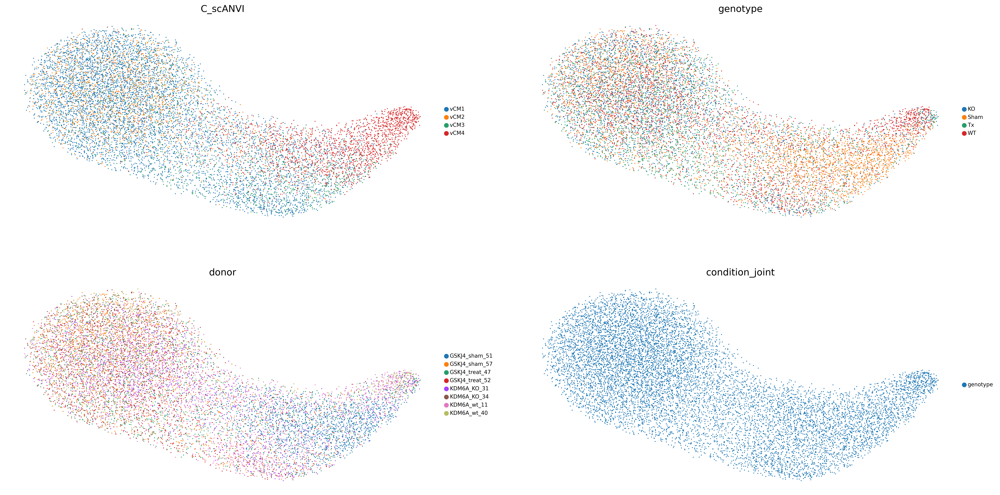

In [45]:
sc.pl.umap(HHH_CMC, frameon = False, color = ['C_scANVI', 'genotype', 'donor', 'condition_joint'], size = 8, legend_fontsize = 8, ncols = 2)

### Calculate directions of upregulation for each latent score and put them to

In [46]:
q_intr_cvae.latent_directions(adata = HHH_CMC)

### Do gene set enrichment test for condition in reference + query using Bayes Factors.

In [51]:
plt.rcParams['figure.figsize'] = [16, 6]

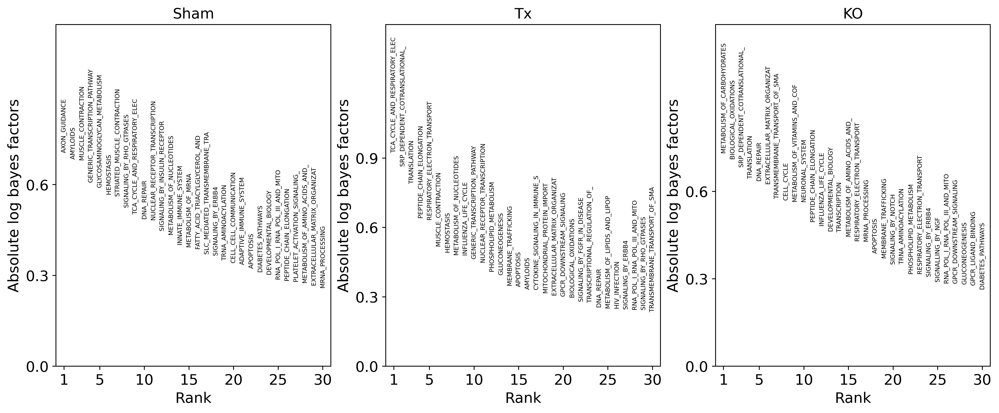

In [57]:
q_intr_cvae.latent_enrich(groups = 'genotype', comparison = ['WT'], use_directions = True, adata = HHH_CMC)
fig = sca.plotting.plot_abs_bfs(HHH_CMC, yt_step = 0.3, scale_y = 1.6, fontsize = 6)

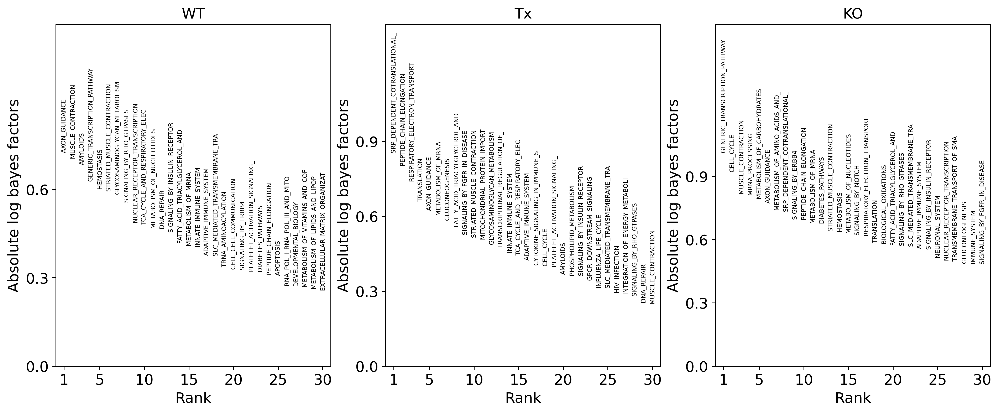

In [58]:
q_intr_cvae.latent_enrich(groups = 'genotype', comparison = ['Sham'], use_directions = True, adata = HHH_CMC)
fig = sca.plotting.plot_abs_bfs(HHH_CMC, yt_step = 0.3, scale_y = 1.6, fontsize = 6)

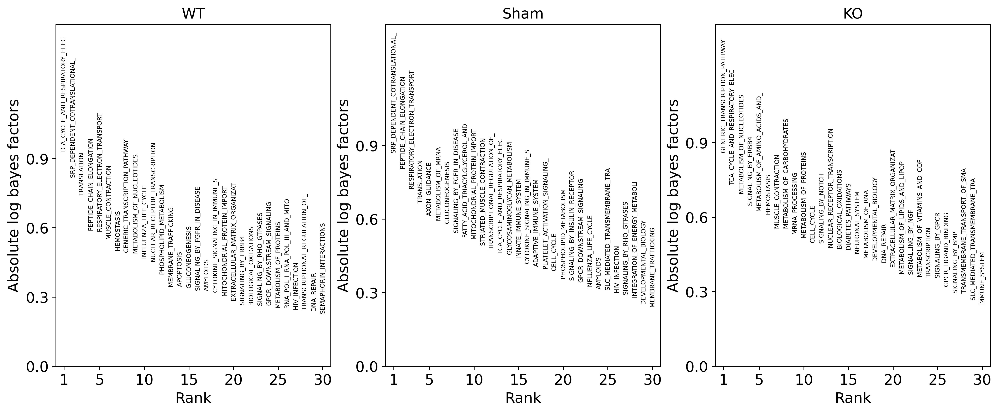

In [60]:
q_intr_cvae.latent_enrich(groups = 'genotype', comparison = 'Tx', use_directions = True, adata = HHH_CMC)
fig = sca.plotting.plot_abs_bfs(HHH_CMC, yt_step = 0.3, scale_y = 1.6, fontsize = 6)

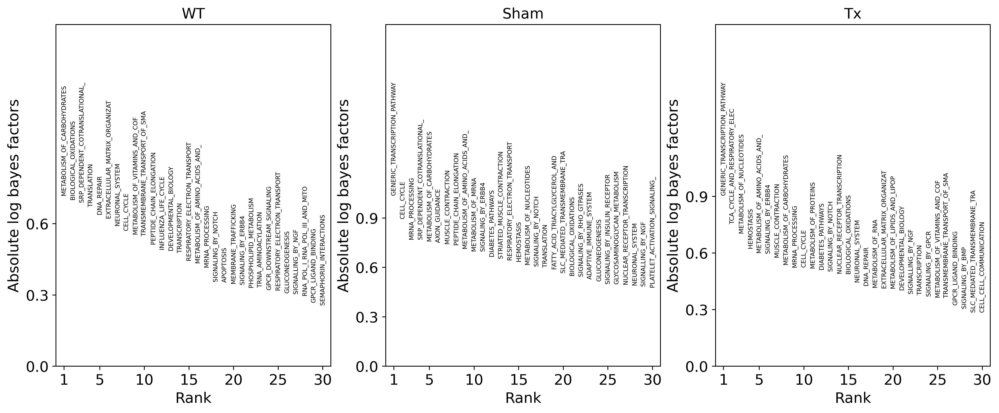

In [61]:
q_intr_cvae.latent_enrich(groups = 'genotype', comparison = 'KO', use_directions = True, adata = HHH_CMC)
fig = sca.plotting.plot_abs_bfs(HHH_CMC, yt_step = 0.3, scale_y = 2, fontsize = 6)

### Plot the latent variables for query + reference corresponding to the annotations 

In [100]:
terms = HHH_CMC.uns['terms']
select_terms = ['SIGNALING_BY_INSULIN_RECEPTOR', 'AMYLOIDS', 'INNATE_IMMUNE_SYSTEM']
idx = [terms.index(term) for term in select_terms]

In [101]:
latents = (q_intr_cvae.get_latent(HHH_CMC.X, HHH_CMC.obs['genotype'], mean = MEAN) * HHH_CMC.uns['directions'])[:, idx]

HHH_CMC.obs['SIGNALING_BY_INSULIN_RECEPTOR'] = latents[:, 0]
HHH_CMC.obs['AMYLOIDS'] = latents[:, 1]
HHH_CMC.obs['INNATE_IMMUNE_SYSTEM'] = latents[:, 2]

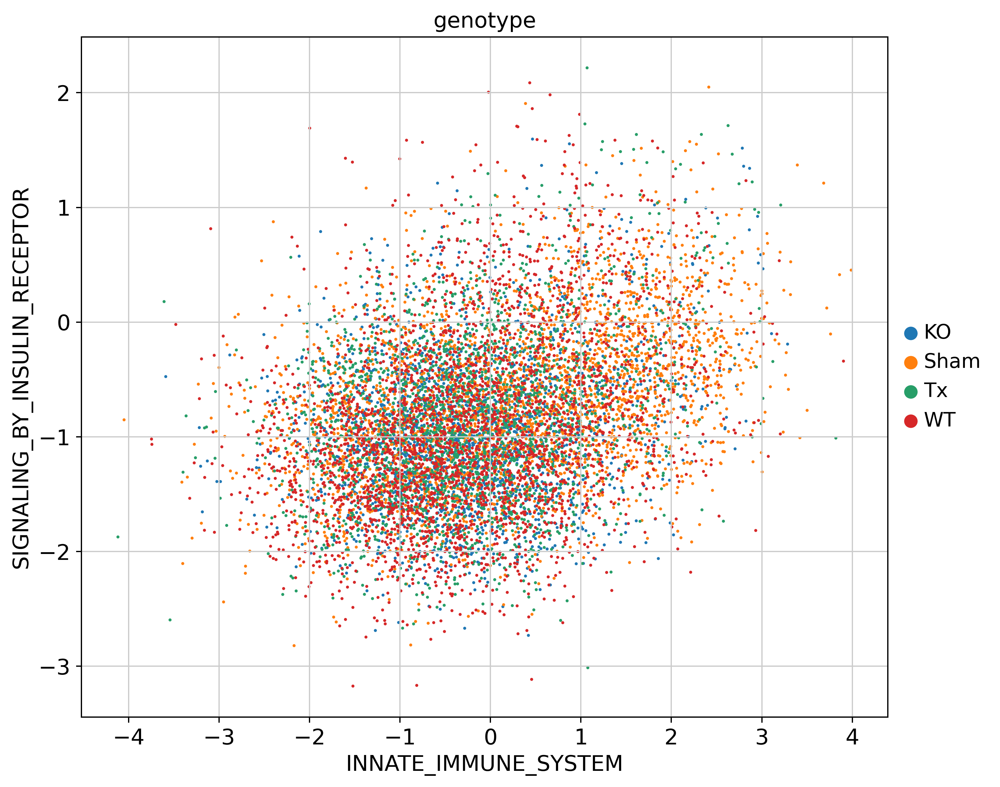

In [102]:
plt.rcParams['figure.figsize'] = [8, 8]
sc.pl.scatter(HHH_CMC, x = 'INNATE_IMMUNE_SYSTEM', y = 'SIGNALING_BY_INSULIN_RECEPTOR', color = 'genotype', size = 15)

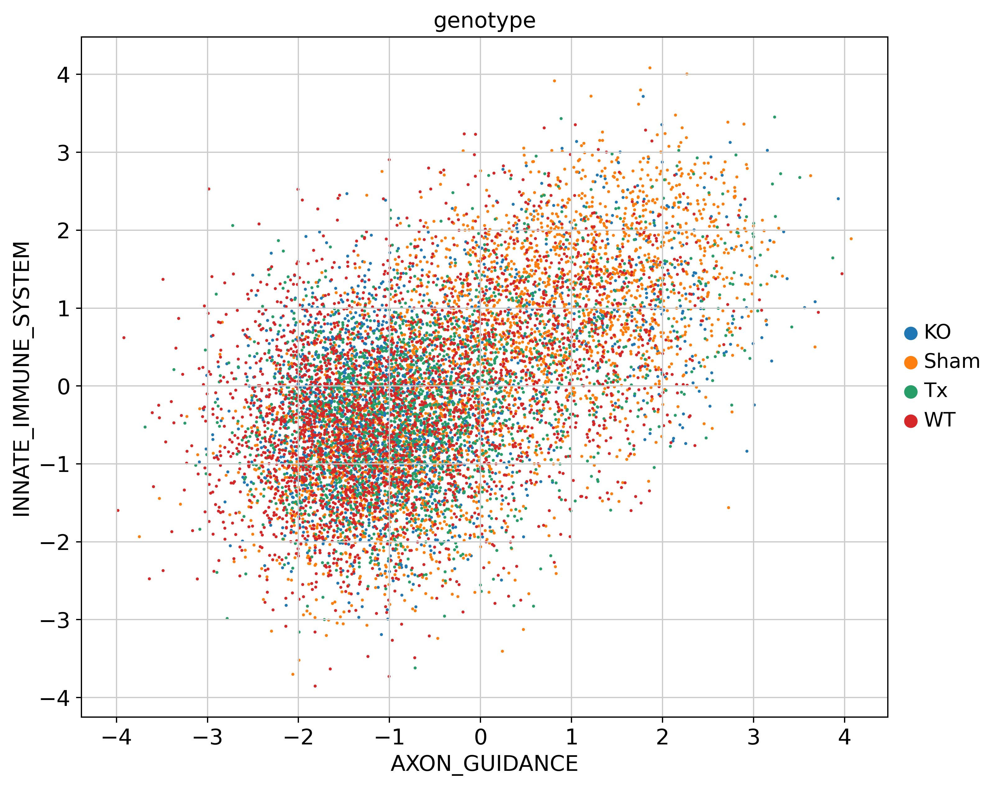

In [94]:
sc.pl.scatter(HHH_CMC, x = 'AXON_GUIDANCE', y = 'INNATE_IMMUNE_SYSTEM', color = 'genotype', size = 15)

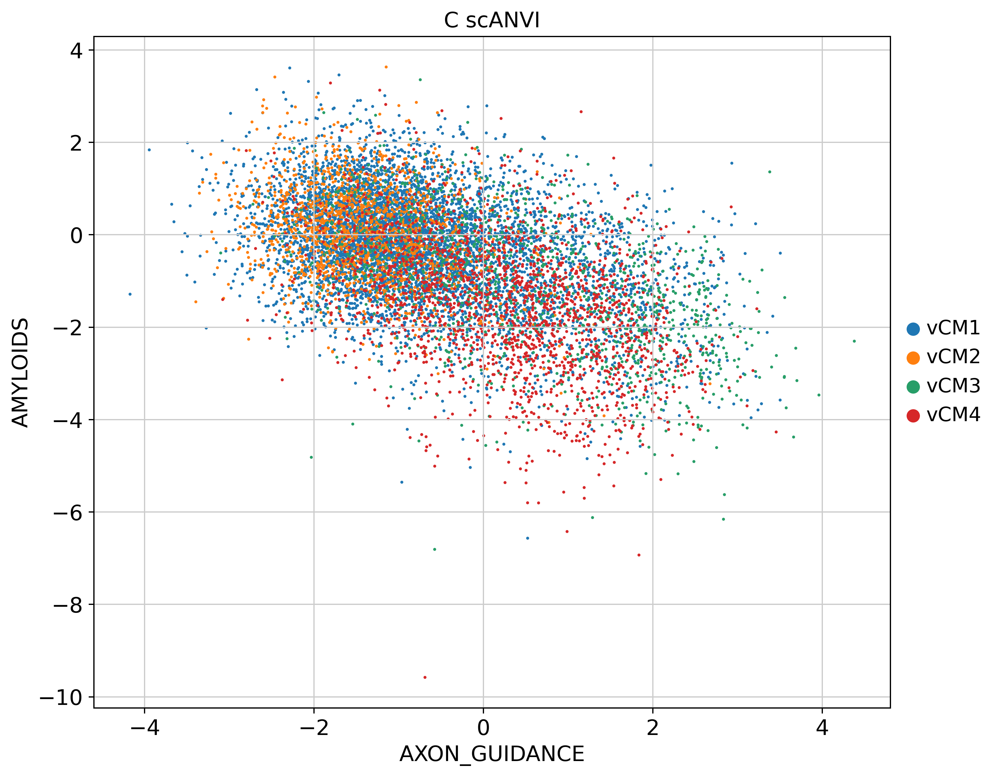

In [89]:
sc.pl.scatter(HHH_CMC, x = 'AXON_GUIDANCE', y = 'AMYLOIDS', color = 'C_scANVI', size = 15)

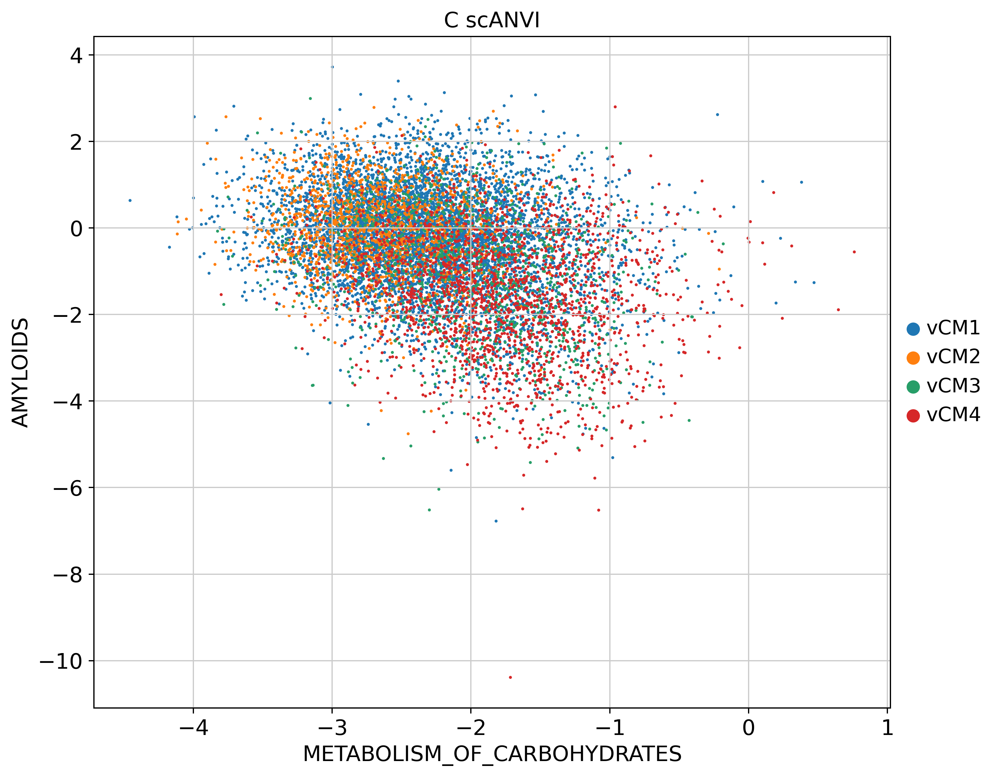

In [69]:
sc.pl.scatter(HHH_CMC, x = 'METABOLISM_OF_CARBOHYDRATES', y = 'AMYLOIDS', color = 'C_scANVI', size = 15)

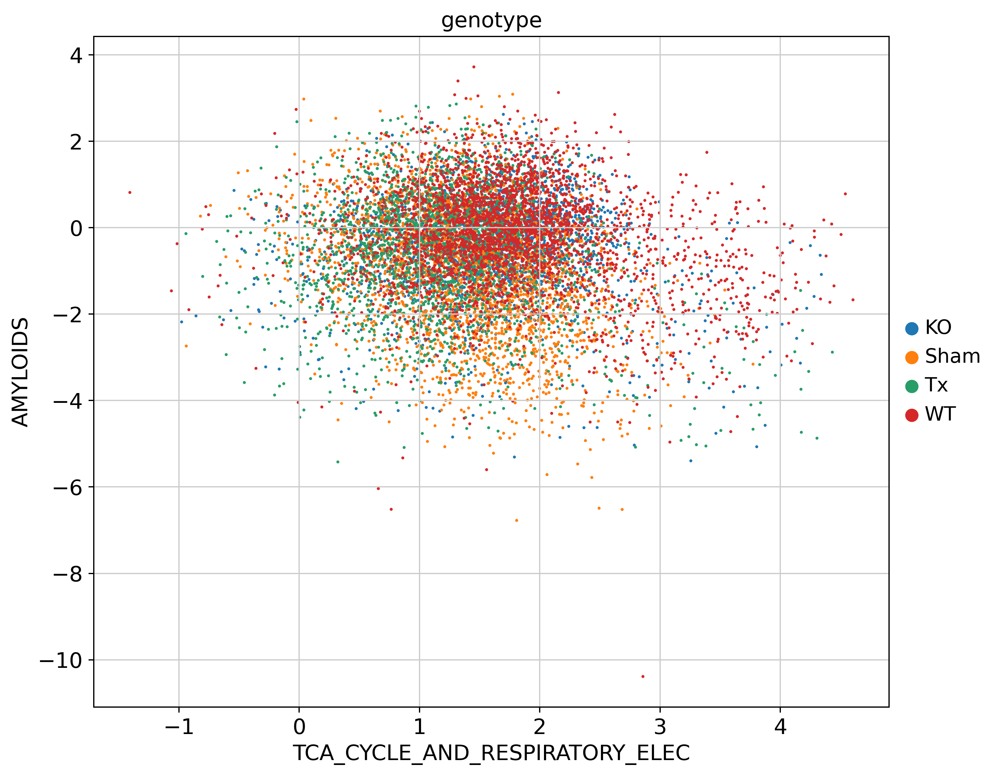

In [70]:
sc.pl.scatter(HHH_CMC, x = 'TCA_CYCLE_AND_RESPIRATORY_ELEC', y = 'AMYLOIDS', color = 'genotype', size = 15)

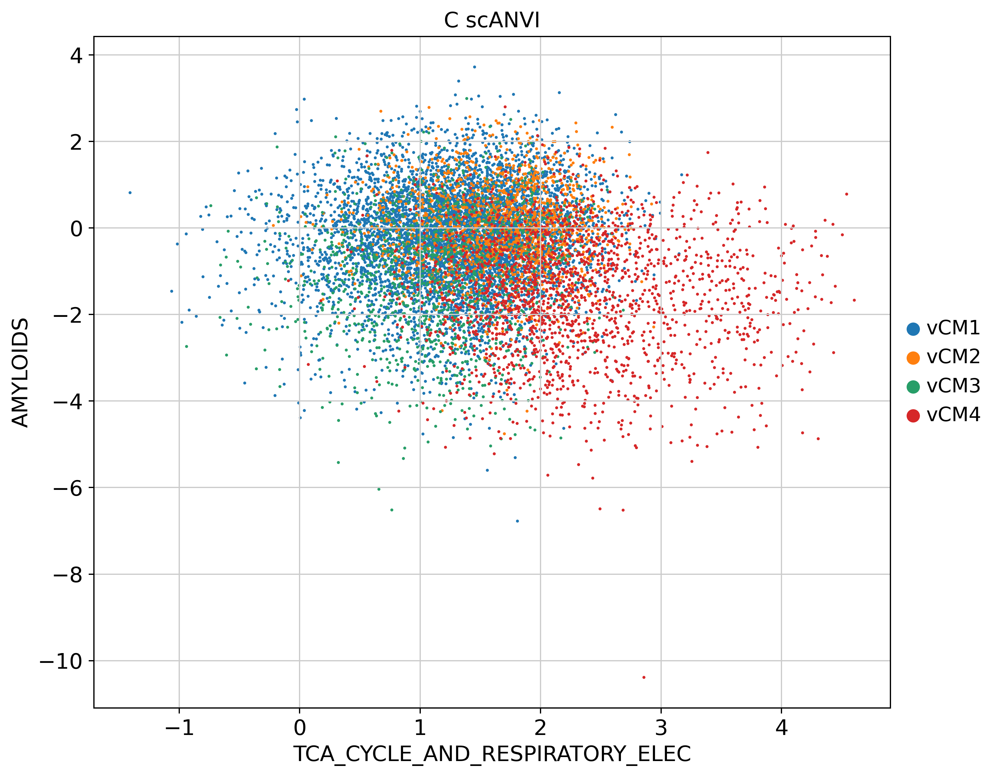

In [71]:
sc.pl.scatter(HHH_CMC, x = 'TCA_CYCLE_AND_RESPIRATORY_ELEC', y = 'AMYLOIDS', color = 'C_scANVI', size = 15)

In [ ]:
sc.pl.scatter(HHH_CMC, x = 'TCA_CYCLE_AND_RESPIRATORY_ELEC', y = 'SRP_DEPENDENT_COTRANSLATIONAL_', color = 'C_scANVI', size = 15)